# Evolutionary Ambience: an example

In [1]:
import numpy as np
from pedalboard import *
from pedalboard.io import AudioFile
import scipy.signal as sig
import scipy.io.wavfile as open_wav
import matplotlib.pyplot as plt
import os
import librosa
import librosa.display
import IPython.display as ipd
from soundfile import write
import project_source as project

## Data exploration and file importing

First we import the two audio files to use, the target audio and the input one.

In [2]:
name_song = "fuzz"
input_name = "songs/" + name_song + "_dry.wav"
target_name = "songs/" + name_song + "_wet.wav"
input, sr= librosa.load(input_name,mono=False)
hop_size = 512
S_target , sr= project.spectrogram.from_file(target_name,hop_size)
S_input , sr= project.spectrogram.from_file(input_name, hop_size)

Now we take a look at the spectrogram of the imported pieces: first we see the spectrogram of the target, then the spectrogram of the raw input.

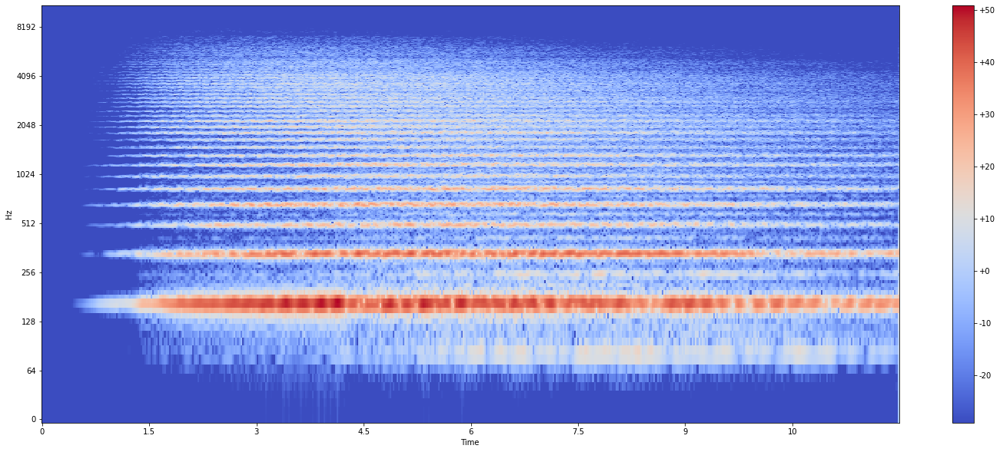

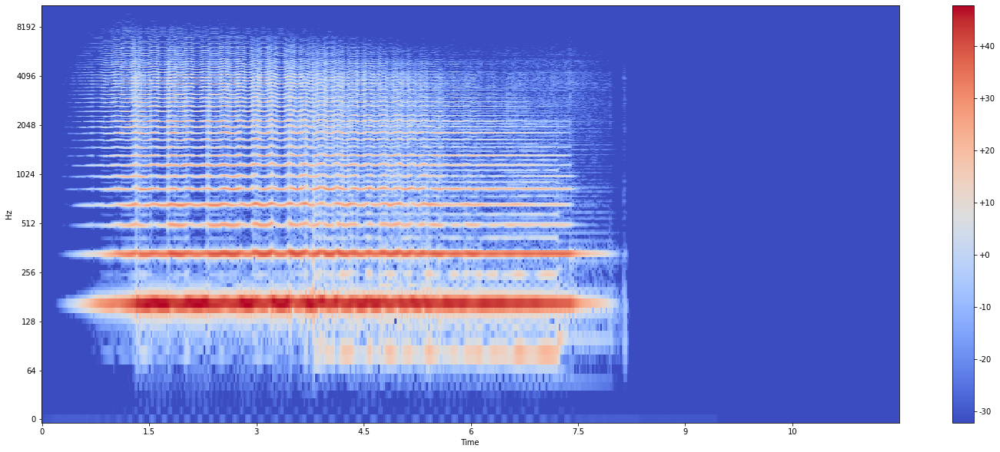

In [3]:
project.spectrogram.plot(S_target[0], sr, hop_size,y_axis='log')
project.spectrogram.plot(S_input[0], sr, hop_size, y_axis='log')

We look at the difference between the two in terms of euclidean norm and plot the spectrogram. The euclidean norm will come in handy to benchmark the fitness of the individuals and see if they're actually improving with respect to the base sound.

In [4]:
S_diff = S_target - S_input
np.linalg.norm(S_diff)

12719.768

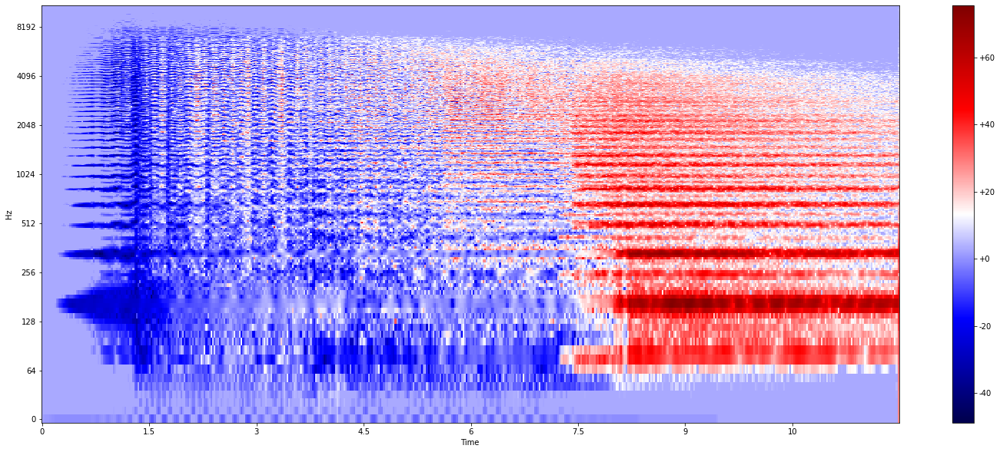

In [5]:
project.spectrogram.plot(S_diff[0], sr, hop_size, y_axis='log', diff=True)

Finally, we listen to the two audio sources.

In [18]:
ipd.Audio(target_name)

In [19]:
ipd.Audio(input_name)

## Experiment 1: DE/rand/1

In [3]:
n = 50
pop = []

for i in range(n):
    individual = project.individual()
    pop.append(individual)

In [4]:
DE_project = project.DE(input,S_target,sr,hop_size)

In [5]:
best = DE_project.evolve(20,pop,1,.5,alpha=.2,beta=.5, decay=1,n_try=0,verboso=True)

Gen. 0 | Best fit: 8300.03125 | Avg. Fitness:  13565.78552734375 | Std. Fitness:  3674.093034742462
Gen. 5 | Best fit: 6190.27001953125 | Avg. Fitness:  10235.4680859375 | Std. Fitness:  1366.9641405226498
Gen. 10 | Best fit: 6190.27001953125 | Avg. Fitness:  9534.85572265625 | Std. Fitness:  1158.114836833184
Gen. 15 | Best fit: 6190.27001953125 | Avg. Fitness:  9277.877021484375 | Std. Fitness:  1115.7053955007755

Best overall individual: 21 , Fitness: 6190.27001953125


In [6]:
best.parameters

[[array([  2.21625196,   4.6762374 ,  63.03111669, -49.0166645 ]),
  array([-6.90745866e+02,  3.11318961e+02,  9.47772076e+00,  5.25486151e+00,
          2.38720633e+03,  1.29938502e+04]),
  array([5.92015976e+02, 3.42676646e+01, 7.63301587e+01, 9.22140047e+01,
         5.53636543e+01, 5.56553261e+01, 1.91323398e+04, 5.35028118e+00,
         5.09193833e+01])],
 ['VariUpDown', 'Aquarius', 0],
 [1.3052578613803045, 19.386176077442755, 74.86249692797101]]

In [7]:
project.utils.set_parameters(best.parameters,project.base_board)
project.base_board.reset()

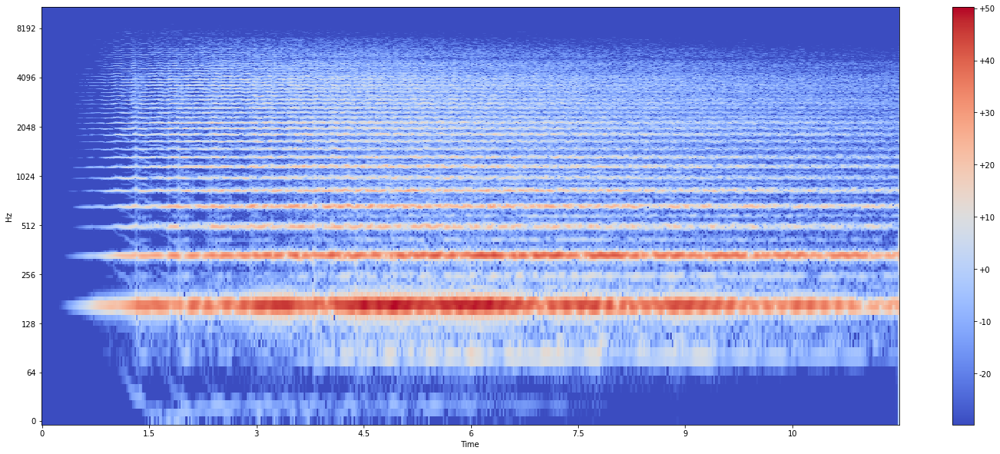

In [8]:
best_guess = project.base_board(input,sr)

S_guess= project.spectrogram.from_array(best_guess,hop_size)
project.spectrogram.plot(S_guess[0],sr,hop_size, y_axis = 'log')


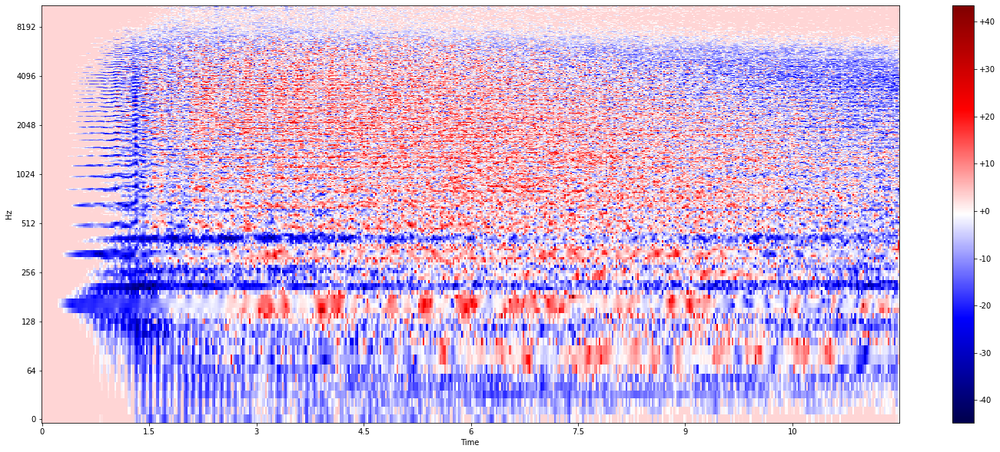

In [25]:
diff = S_target - S_guess
project.spectrogram.plot(diff[0],sr,hop_size, y_axis = 'log', diff= True)


In [60]:
project.base_board.reset()
project.base_board.reset()
with AudioFile(input_name,"r") as f:
    with AudioFile("output.wav", 'w', f.samplerate, 2) as o:
        while f.tell() < f.frames:
            chunk = f.read(int(f.samplerate))
            effected = project.base_board(chunk, f.samplerate, reset=False)
            o.write(effected)

In [61]:
ipd.Audio("output.wav")

In [56]:
ipd.Audio(target_name)

## Experiment 2: DE/rand/1 + HJ optimization

In [28]:
n = 50
pop = []

for i in range(n):
    individual = project.individual()
    pop.append(individual)

In [29]:
best = DE_project.evolve(50,pop,1,.5,alpha=.2,decay=1,beta=.5,n_try=3,verboso=True)

Gen. 0 | Best fit: 7653.330078125 | Avg. Fitness:  12068.27095703125
Gen. 5 | Best fit: 7446.2236328125 | Avg. Fitness:  10063.960556640624
Gen. 10 | Best fit: 7446.2236328125 | Avg. Fitness:  9701.192177734374
Gen. 15 | Best fit: 7446.2236328125 | Avg. Fitness:  9313.746201171874
Gen. 20 | Best fit: 7446.2236328125 | Avg. Fitness:  9079.1606640625
Gen. 25 | Best fit: 7446.2236328125 | Avg. Fitness:  9018.370458984375
Gen. 30 | Best fit: 7445.2900390625 | Avg. Fitness:  8896.629052734375
Gen. 35 | Best fit: 7445.2900390625 | Avg. Fitness:  8792.05455078125
Gen. 40 | Best fit: 6966.404296875 | Avg. Fitness:  8674.50296875
Gen. 45 | Best fit: 6966.404296875 | Avg. Fitness:  8654.0576953125

Best overall individual: 32 , Fitness: 6966.404296875


In [33]:
best.parameters

[[array([  1.50429691,  42.46249984, -14.64259518,  25.93959823]),
  array([-4.17368848e+02,  7.29129214e+02,  1.25041268e+00,  4.37505421e+01,
          1.69678832e+03,  3.78936499e+03]),
  array([ 8.02301634e+02,  4.29602352e+01,  3.39553061e+01,  4.10564816e+01,
         -1.58192915e+00,  2.84391808e+02,  3.72424835e+03,  3.50763294e+00,
          5.88570682e+01])],
 ['Ocho', 'Hydra', 0],
 [12.937925007933359, 10.399555892257059, 89.68884182814134]]

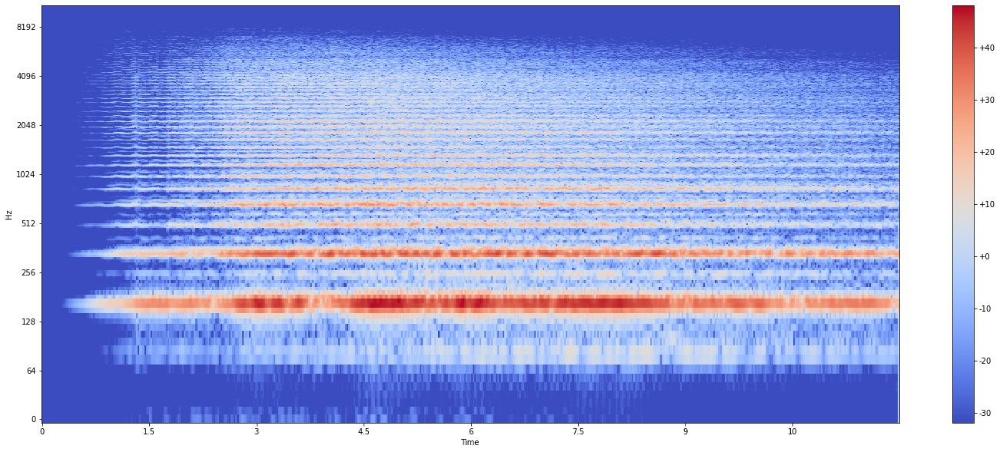

In [35]:
project.utils.set_parameters(best.parameters,project.base_board)
project.base_board.reset()
best_guess = project.base_board(input,sr)

S_guess= project.spectrogram.from_array(best_guess,hop_size)
project.spectrogram.plot(S_guess[0],sr,hop_size, y_axis = 'log')

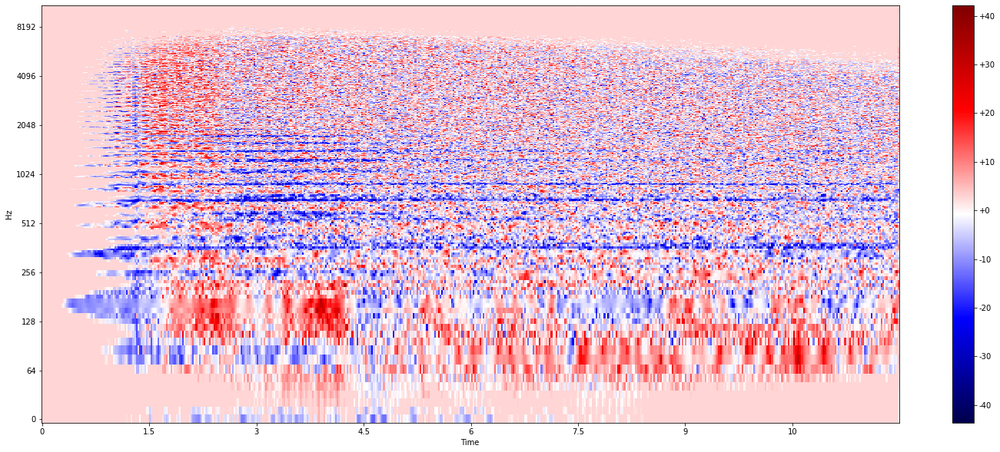

In [36]:
diff = S_target - S_guess
project.spectrogram.plot(diff[0],sr,hop_size, y_axis = 'log', diff= True)

In [37]:
project.base_board.reset()
project.base_board.reset()
with AudioFile(input_name,"r") as f:
    with AudioFile("output.wav", 'w', f.samplerate, 2) as o:
        while f.tell() < f.frames:
            chunk = f.read(int(f.samplerate))
            effected = project.base_board(chunk, f.samplerate, reset=False)
            o.write(effected)

In [38]:
ipd.Audio("output.wav")

In [31]:
ipd.Audio(target_name)

## Experiment 3: JADE

In [3]:
n = 50
pop = []

for i in range(n):
    individual = project.individual()
    pop.append(individual)

In [4]:
DE_project = project.JADE_arc(input,S_target,sr,hop_size)

In [5]:
c = 1/10
p_best = 5
best2 = DE_project.evolve(
        n_gen = 50,
        pop = pop,
        alpha_mutation=.5,
        p_crossover= .5,
        p_best = p_best,
        c = c,
        dim_arc=p_best*2,
        alpha=.2,
        decay=1,
        beta=.5,
        n_try=0,
        p_lamarckian=1,
        verboso=True)

Gen. 0 | Best fit: 7553.8726 | Avg. Fitness: 12734.394814453124 | Std. Fitness:  3348.942663716741 | alpha_mutation: 0.508 | p_crossover: 0.491
Gen. 5 | Best fit: 7266.7451171875 | Avg. Fitness: 10020.85154296875 | Std. Fitness:  1287.8814972189737 | alpha_mutation: 0.538 | p_crossover: 0.338


KeyboardInterrupt: 

In [81]:
best2.parameters

[[array([ -0.55338997,  24.68547915, -23.11502149, -31.48344356]),
  array([ 991.66556283,   18.62832811,   18.75964176,   68.27960392,
         1829.14827722, 4196.29502498]),
  array([ 423.3619285 ,    4.46880721,   37.09093785,   59.35356721,
           15.22513524,  556.42763427, 4430.6941593 ,    6.37488884,
           61.40564942])],
 ['Symphonic', 'Cirrus Minor', 0],
 [15.18785392400627, 4.0043623270767466, 51.05283797897251]]

In [83]:
project.utils.set_parameters(best2.parameters,project.base_board)

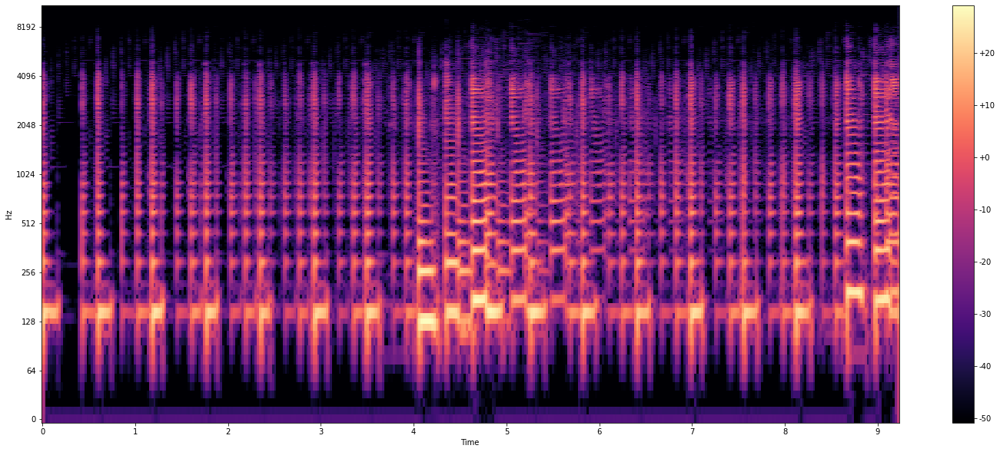

In [85]:
best_guess = project.base_board(input,sr)
best_guess = project.base_board(input,sr)
project.utils.clip_signal(best_guess)
S_guess = project.spectrogram.from_array(best_guess,hop_size)
project.spectrogram.plot(S_guess[0],sr,hop_size, y_axis = 'log')


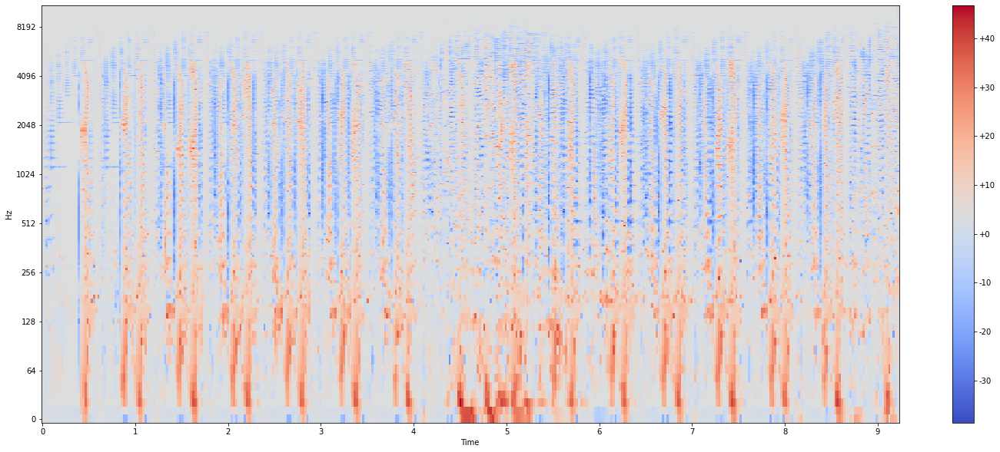

In [86]:
diff = S_target - S_guess

project.spectrogram.plot(diff[0],sr,hop_size, y_axis = 'log')

In [89]:
project.base_board.reset()

with AudioFile(input_name,"r") as f:
    with AudioFile("output.wav", 'w', f.samplerate, 2) as o:
        while f.tell() < f.frames:
            chunk = f.read(int(f.samplerate))
            effected = project.base_board(chunk, f.samplerate, reset=False)
            o.write(effected)

In [90]:
ipd.Audio("output.wav")

In [47]:
ipd.Audio(target_name)

## Experiment 4: JADE + HJ optimization

In [47]:
n = 50
pop = []

for i in range(n):
    individual = project.individual()
    pop.append(individual)

In [48]:
DE_project = project.JADE_arc(input,S_target,sr,hop_size)

In [49]:
c = 1/10
p_best = 5
best2 = DE_project.evolve(
        n_gen = 50,
        pop = pop,
        alpha_mutation=.5,
        p_crossover= .5,
        p_best = p_best,
        c = c,
        dim_arc=p_best*2,
        alpha=.2,
        decay=1,
        beta=.5,
        n_try=3,
        p_lamarckian=1,
        verboso=True)

Gen. 0 | Best fit: 7940.9111328125 | Avg. Fitness: 12124.015341796876 | alpha_mutation: 0.516 | p_crossover: 0.475
Gen. 5 | Best fit: 7599.23486328125 | Avg. Fitness: 10367.005390625 | alpha_mutation: 0.542 | p_crossover: 0.325
Gen. 10 | Best fit: 6627.21044921875 | Avg. Fitness: 9757.213896484374 | alpha_mutation: 0.555 | p_crossover: 0.219
Gen. 15 | Best fit: 6627.21044921875 | Avg. Fitness: 9361.8683984375 | alpha_mutation: 0.532 | p_crossover: 0.148
Gen. 20 | Best fit: 6627.21044921875 | Avg. Fitness: 9218.003046875 | alpha_mutation: 0.610 | p_crossover: 0.095
Gen. 25 | Best fit: 6627.21044921875 | Avg. Fitness: 9097.976259765624 | alpha_mutation: 0.616 | p_crossover: 0.064
Gen. 30 | Best fit: 5818.75537109375 | Avg. Fitness: 8927.146171875 | alpha_mutation: 0.643 | p_crossover: 0.044
Gen. 35 | Best fit: 5818.75537109375 | Avg. Fitness: 8828.60466796875 | alpha_mutation: 0.661 | p_crossover: 0.032
Gen. 40 | Best fit: 5818.75537109375 | Avg. Fitness: 8704.55884765625 | alpha_mutatio

In [39]:
best2.parameters

[[array([ 2.64075057, 13.04588043,  0.6161139 , 10.36243924]),
  array([-1.12455166e+02,  2.04810495e+01,  7.36975650e+00,  6.67831060e+01,
          8.86066032e+02,  1.21721514e+04]),
  array([1469.50318029,   75.94735496,   40.19531623,   66.915772  ,
          -59.74366661,  110.31568198, 1838.91012403,    9.77120529,
           58.25200995])],
 ['Ensemble360', 'Hydra', 0],
 [14.579597022455681, 3.5373652316307123, 95.52553779627708]]

In [40]:
project.utils.set_parameters(best2.parameters,project.base_board)

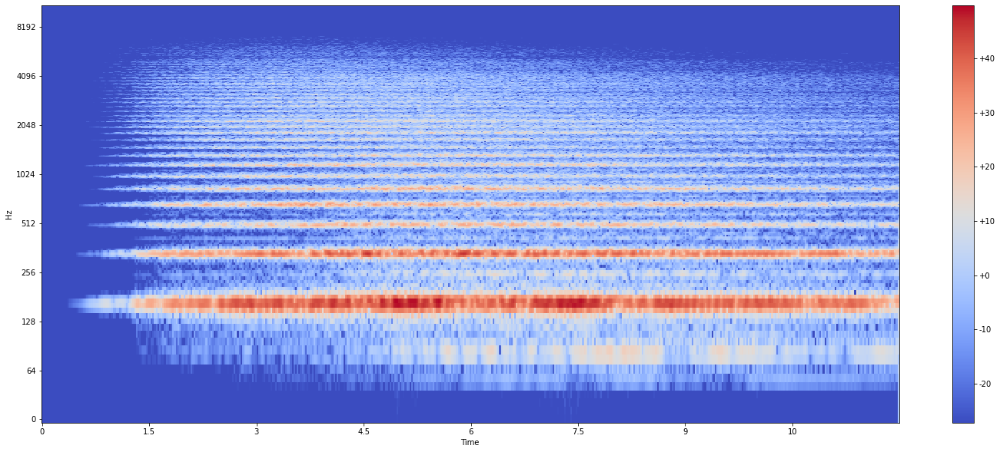

In [42]:
best_guess = project.base_board(input,sr)
best_guess = project.base_board(input,sr)
project.utils.clip_signal(best_guess)
S_guess = project.spectrogram.from_array(best_guess,hop_size)
project.spectrogram.plot(S_guess[0],sr,hop_size, y_axis = 'log')


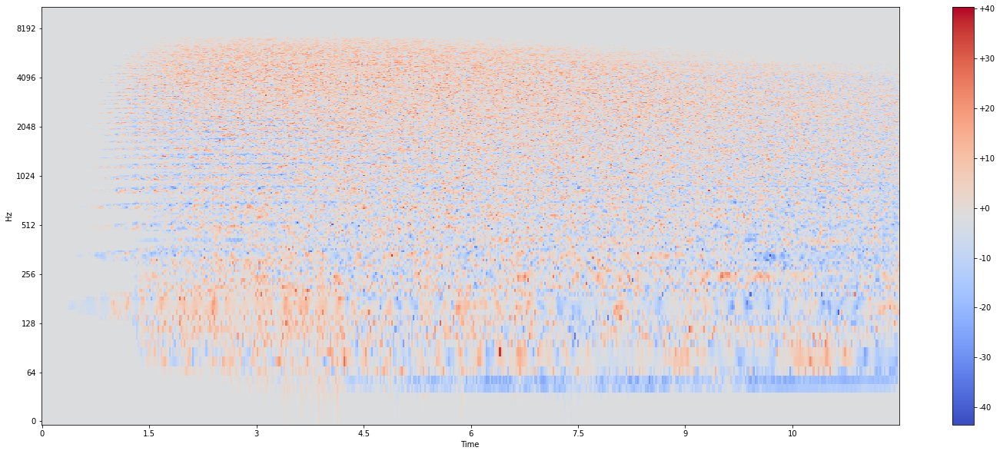

In [43]:
diff = S_target - S_guess

project.spectrogram.plot(diff[0],sr,hop_size, y_axis = 'log')

In [45]:
project.base_board.reset()

with AudioFile(input_name,"r") as f:
    with AudioFile("output.wav", 'w', f.samplerate, 2) as o:
        while f.tell() < f.frames:
            chunk = f.read(int(f.samplerate))
            effected = project.base_board(chunk, f.samplerate, reset=False)
            o.write(effected)

In [46]:
ipd.Audio("output.wav")

In [37]:
ipd.Audio(target_name)